In [1]:
import sys
import os
# Add the directory containing 'thesis_utils.py' to the system path
sys.path.append(os.path.abspath('..'))  # If 'thesis_utils.py' is one level up
# Or use this if it's in the same directory as the notebook:
# sys.path.append(os.getcwd())
# os.environ["JULIA_NUM_THREADS"] = "8" 
os.environ["PYTHON_JULIACALL_HANDLE_SIGNALS"] = "yes"
os.environ["PYTHON_JULIACALL_THREADS"] = "auto"
os.environ["PYTHON_JULIACALL_OPTLEVEL"] = "3"
from pysr import PySRRegressor
import pandas as pd
import numpy as np
from ydata_profiling import ProfileReport

from thesis_utils import *

Detected IPython. Loading juliacall extension. See https://juliapy.github.io/PythonCall.jl/stable/compat/#IPython


In [57]:
import importlib
import thesis_utils  # or whatever your module is called

importlib.reload(thesis_utils)

from thesis_utils import *

In [2]:
data = pd.read_csv("C:/Users/svenl/vs_code_projects/hyperRealDataDescriber/data/credit_score/cleaned_credit_score_v2.csv")
# sub sampling due to degrading performance with too large datasets in denoising and SR
data_sample = data.sample(n=9600, random_state=42)

In [3]:
# Generate the profiling report
profile_full = ProfileReport(data, title="cleaned_credit_score_v2", explorative=True)

# Display the report in the notebook
profile_full.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [3]:
# variable assignment according to correlation structure
independents_lst = ['Credit_History_Age', 'Delay_from_due_date', 'Num_Bank_Accounts', 'Num_Credit_Inquiries', 'Num_of_Delayed_Payment', 'Outstanding_Debt']
dependent_var = 'Interest_Rate'
X = data_sample[independents_lst].to_numpy()
y = data_sample[dependent_var].to_numpy()
data_sample = data_sample.reset_index()

12**2 * RBF(length_scale=30) + WhiteKernel(noise_level=20)


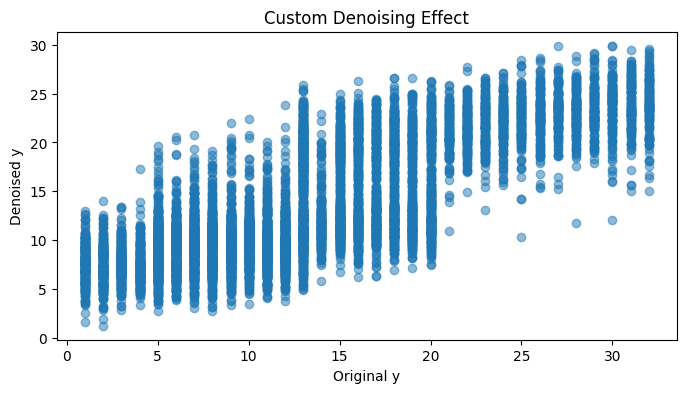

In [4]:
%matplotlib inline
y_denoised = bound_denoise(X, y, length_scale_bounds=(1e-3, 30), noise_level_bounds=(1e-5, 20), show_denoising_effect=True)

In [5]:
sr_model = PySRRegressor(
        niterations=256,  # Number of iterations to search for equations
        binary_operators=["+", "-", "*", "/"],
        unary_operators=["sin", "cos", "exp", "log", "abs", "sqrt"],
        elementwise_loss="loss(x, y) = (x - y)^2",  # Define loss function (mean squared error)
        verbosity=0,
        maxsize=50
    )
sr_model.fit(X, y_denoised)

PySRRegressor.equations_ = [
	    pick     score                                           equation  \
	0         0.000000                                                 x4   
	1         0.292937                                            x2 + x3   
	2         0.044046                              (x3 + 1.0868266) + x2   
	3         0.054041                   x3 + ((x5 * 0.00086811365) + x2)   
	4         0.042656              sqrt(x4) + (x2 + (x5 * 0.0030660662))   
	5         0.117960      (x2 + (x3 / 1.4312054)) + (x5 * 0.0020272392)   
	6         0.048863  ((x5 * 0.0021067117) + x2) + sqrt(x3 / 0.2255076)   
	7         0.083732  (x5 * 0.0019682157) + ((x2 + (x4 + x3)) * 0.41...   
	8         0.086913  ((x5 * 0.0019722437) + sqrt(x4)) + ((x2 + x3) ...   
	9         0.010917  sqrt(abs(x1)) + ((x5 * 0.0017040008) + ((x2 + ...   
	10        0.004539  ((x3 + x2) / 1.8982357) + (sqrt(abs(x1) - -2.3...   
	11        0.093016  ((x2 + x3) / 2.0765636) + ((x5 * 0.0016528007)...   
	12        0.000155  ((((x2 + x3) / 2.0777993) + sqrt(x4)) + (abs(x...   
	13        0.002051  ((x5 * 0.0016565223) + ((x1 * 0.08080527) + (s...   
	14        0.023030  (((x3 + x2) + (sqrt(x4) * 2.9010193)) / 2.0010...   
	15        0.001143  abs((((x2 + (sqrt(x4) * 2.9010193)) + x3) / 2....   
	16        0.026669  (((x3 + ((sqrt(x4) * 2.9682012) + x2)) / 2.001...   
	17        0.006538  ((((2.9010193 * sqrt(x4)) + x3) + x2) / 2.0010...   
	18        0.017315  (0.001784894 * x5) + ((((sqrt(x4 - -1.3593413)...   
	19        0.049506  (x2 * 0.5755806) + (5.988622 - ((x3 * -14.0456...   
	20  >>>>  0.073118  sqrt(x4) + ((3.685354 - (x3 * (-12.046985 / (x...   
	21        0.000605  ((x2 + (x4 * 0.41625777)) + (9.73566 - (x3 * (...   
	22        0.011000  (((x2 - ((x3 + -1.3251587) * (-22.382603 / (ex...   
	23        0.028850  (((x2 + 8.23964) - ((x3 / (exp((76.93974 * x0)...   
	24        0.004761  (x2 + (12.374586 - (x3 * (-23.167046 / (x3 + e...   
	25        0.033511  (((x2 + 6.3446636) - ((x3 * -17.416512) / (x3 ...   
	26        0.053674  (((x4 * 0.42468578) + x2) + (12.247052 - ((x3 ...   
	27        0.000334  (((x4 * 0.42052546) + (x2 + 12.207441)) - ((-2...   
	28        0.030428  ((((-24.791857 / (x3 + exp(((x0 * -9.7296295) ...   
	29        0.000152  ((((-24.780046 / (exp(((x0 * ((x1 / 6.401407) ...   
	30        0.025538  ((x2 + (11.010917 - ((x3 * -21.743) / (exp((((...   
	31        0.005109  (((x2 + 11.219521) - ((-22.404087 * x3) / (x3 ...   
	32        0.048915  (((x2 + 11.4728155) - ((x3 / (x3 + exp((((((x1...   
	33        0.000222  (((x3 + x4) * 0.19261508) - -0.21534947) + (((...   
	34        0.006412  ((x3 + x4) * 0.18848512) + ((((x2 + 15.167831)...   
	35        0.002331  (((x3 + x4) * 0.18558758) + (((x2 + 15.171084)...   
	36        0.001329  (((x2 + (15.162591 - ((x3 * -21.309303) / (x3 ...   
	37        0.001012  (((x2 + ((15.158492 - (x3 * -21.073353)) / (x3...   
	
	         loss  complexity  
	0   25.182234           1  
	1   14.016917           3  
	2   12.834963           5  
	3   11.520081           7  
	4   11.039012           8  
	5    9.810716           9  
	6    9.342858          10  
	7    8.592421          11  
	8    7.877157          12  
	9    7.791631          13  
	10   7.721218          15  
	11   7.035408          16  
	12   7.034315          17  
	13   7.019902          18  
	14   6.860083          19  
	15   6.852249          20  
	16   6.671922          21  
	17   6.628444          22  
	18   6.514658          23  
	19   6.199997          24  
	20   5.762843          25  
	21   5.759358          26  
	22   5.696350          27  
	23   5.534360          28  
	24   5.481908          30  
	25   5.301246          31  
	26   5.024209          32  
	27   5.022529          33  
	28   4.872004          34  
	29   4.871264          35  
	30   4.748438          36  
	31   4.700166          38  
	32   4.262124          40  
	33   4.260231          42  
	34   4.205943          44  
	35   4.186377          46  
	36   4.16

In [143]:
# 20250422_220910_EmTEJm
# candidate_function = generate_candidate_function("(((x4 * 0.42468578) + x2) + (12.247052 - ((x3 / (exp((((8.427565 - (x1 / 7.030286)) * x0) * 9.941596) / (x0 + (x5 / 3.7192376))) + x3)) * -27.02335))) * 0.427453")
# candidate_function = generate_candidate_function("0.5136726*x2 + 1.2973638799338*sqrt(x4) + 0.5136726*sqrt(Abs(x1)) + 0.5136726*Abs(x3 + log(x5)*sin(2.48172932259734*sin(log(x5) - 0.88440996)))")
candidate_function = generate_candidate_function("sqrt((x2 * x4) + (((x3 * (x1 + sqrt(x5))) / 3.2992833) + 54.727142)) + (x0 * -0.11721187)")
# candidate_function = generate_candidate_function("sqrt(sqrt((abs(((x5 * 0.023730611) + abs(x1)) - x0) + x4) * 5.247526) * (x2 + x3))")


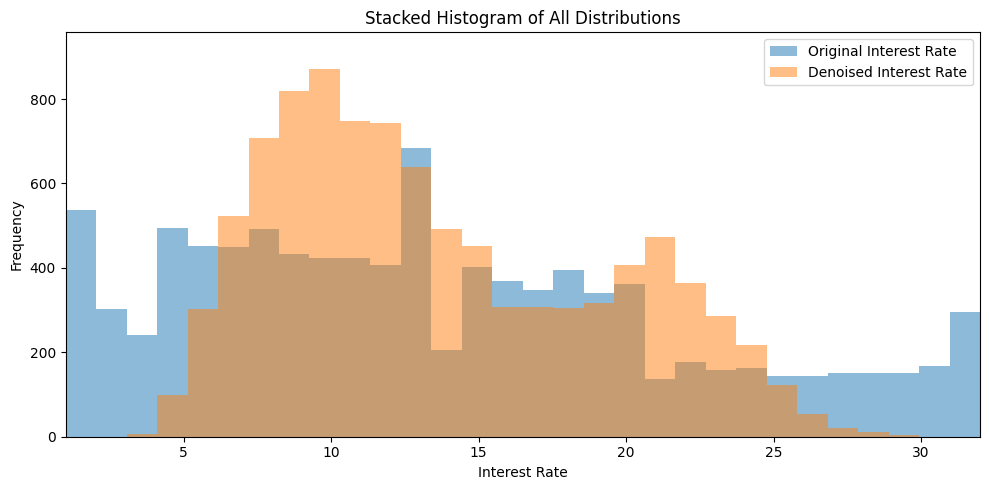

In [144]:
# X_aux = X[:, 1:6]
# y_denoised = candidate_function(X_aux)
y_denoised = candidate_function(X)
plot_histograms([(y, 'Original Interest Rate', None), (y_denoised, 'Denoised Interest Rate', None)], 'Interest Rate', stack=True, figsize_per_plot=(10, 5))

<Figure size 640x480 with 0 Axes>

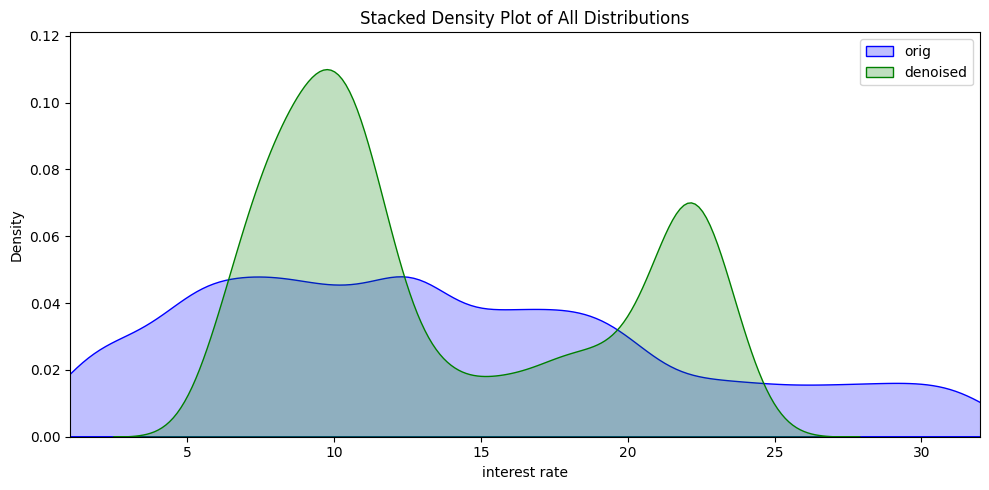

In [71]:
plot_densities([(y, 'orig', 'blue'), (y_denoised, 'denoised', 'green')], 'interest rate', stack=True, figsize_per_plot=(10, 5))

In [8]:
X_total = data[['Credit_History_Age', 'Delay_from_due_date', 'Num_Bank_Accounts', 'Num_Credit_Inquiries', 'Num_of_Delayed_Payment', 'Outstanding_Debt']].to_numpy()
y_total = data['Interest_Rate'].to_numpy()

In [72]:
y_denoised_total = candidate_function(X_total)

In [73]:
orig_residuals = y_total - y_denoised_total

In [74]:
y_renoised, best_amp, errors, _ = renoise_predictions(y_total, y_denoised_total, method='stratified', seed=42, clip_lower=0, clip_upper=None, original_residuals=None, tail_replace=True, lower_percentile=50)
# ignore error in orig_residuals after first run

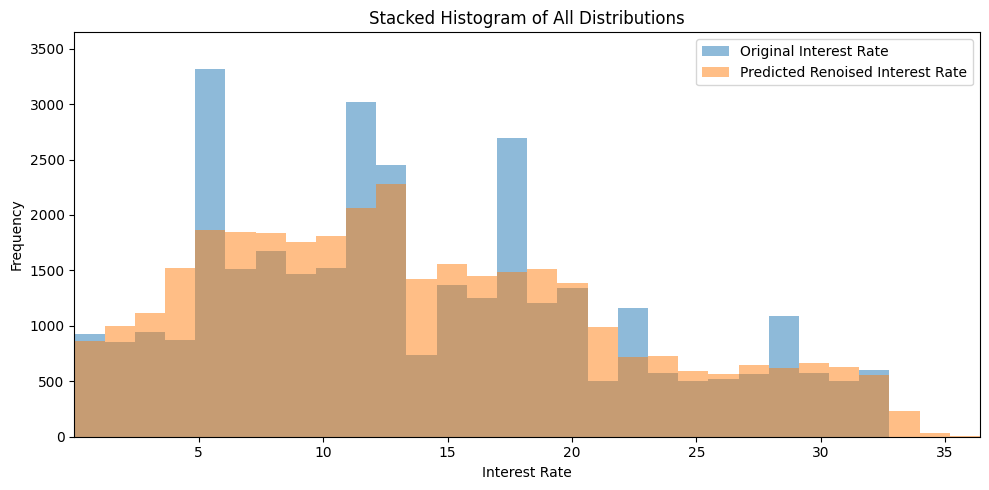

In [75]:
plot_histograms([(y_total, 'Original Interest Rate', None), (y_renoised, 'Predicted Renoised Interest Rate', None)], 'Interest Rate', stack=True, figsize_per_plot=(10, 5))

<Figure size 640x480 with 0 Axes>

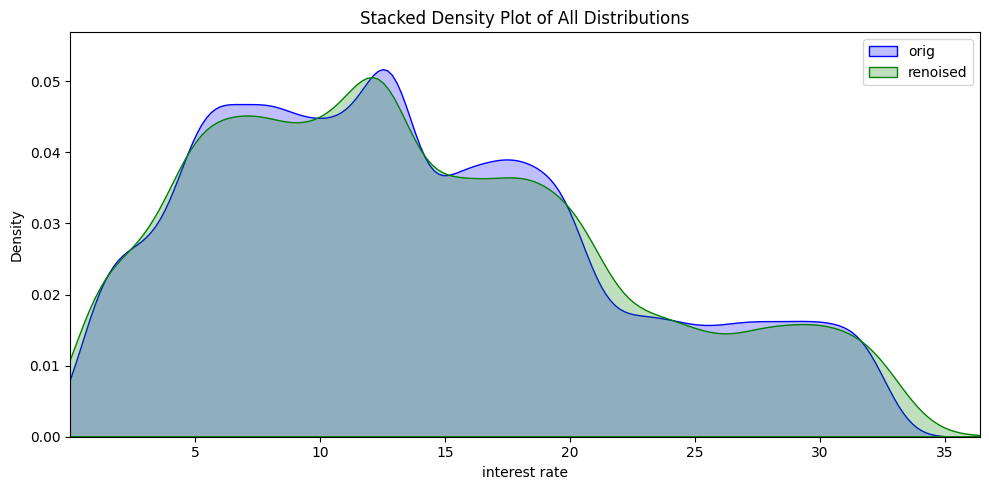

In [76]:
plot_densities([(y_total, 'orig', 'blue'), (y_renoised, 'renoised', 'green')], 'interest rate', stack=True, figsize_per_plot=(10, 5))

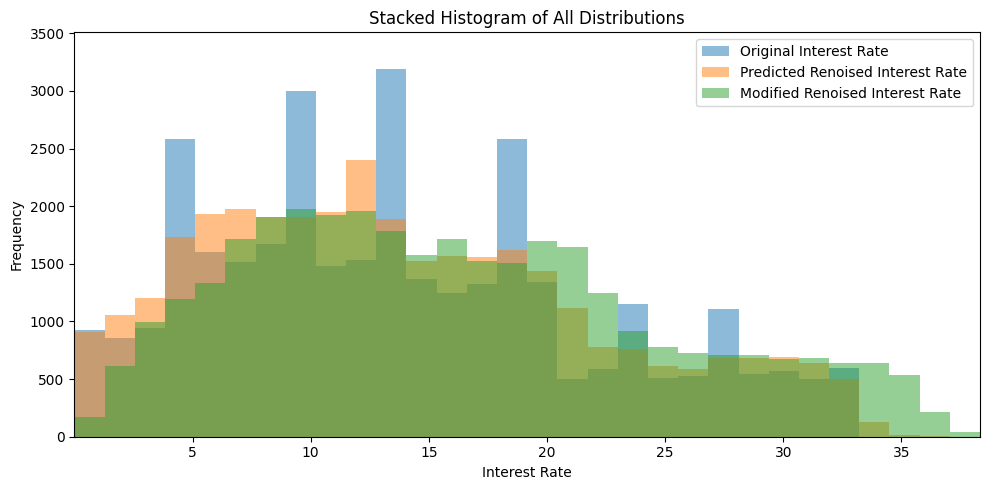

In [106]:
mod_candidate_function = generate_candidate_function("(((x4 * 0.42468578) + 2*x2) + (12.247052 - ((x3 / (exp((((8.427565 - (x1 / 7.030286)) * x0) * 9.941596) / (x0 + (x5 / 3.7192376))) + x3)) * -27.02335))) * 0.427453")
mod_y_denoised_total = mod_candidate_function(X_total)
mod_y_renoised, best_amp, errors, _ = renoise_predictions(y_total, mod_y_denoised_total, method='stratified', amplification_factor=1.0, seed=42, clip_lower=0, clip_upper=None, original_residuals=orig_residuals, tail_replace=True, lower_percentile=50)
# ignore error in orig_residuals after first run
plot_histograms([(y_total, 'Original Interest Rate', None), (y_renoised, 'Predicted Renoised Interest Rate', None), (mod_y_renoised, 'Modified Renoised Interest Rate', None)], 'Interest Rate', stack=True, figsize_per_plot=(10, 5))